# ML4CV project work

Summary: Improving and explaining instance segmentation on a litter detection dataset

Members:
- Dell'Olio Domenico
- Delvecchio Giovanni Pio
- Disabato Raffaele

The project was developed in order to improve instance segmentation results on the [TACO Dataset](http://tacodataset.org/).

We decided to implement and test various architectures, among the highest scoring on COCO instance segmentation datasets, in order to compare their performances.
We also tested some explainability methods on these models to try and explain model predictions.

## This notebook contains:
- Various Grad-CAMs (Gradient-weighted Class Activation Mapping) techniques for eXplainable Artificial Intelligence (XAI) applied to the Mask Frozen DETR (Detector).

We explored various Grad-CAM variants, including the original Grad-CAM, AblationCAM, and ScoreCAM, providing definitions and illustrative examples of their usage.

Through these techniques, we aim to gain deeper insights into the inner workings of the Mask-Frozen DETR model, specifically focusing on how it arrives at its predictions.

We tested some of this techniques also on the MaskDINO model, but due to its intensive resouce requirements and complex library structure, most of them were either unusable or induced OOM errors. The only working CAM method was the EigenCAM, which returned similar results as its extension to semantic segmentation contained in "Segmentation-based XAI.ipynb". Because of this we decided to discard those results and keep only the one on Mask-Frozen DETR.

## Prepare the notebook

Run this section once and restart the runtime!

In [ ]:
# clone repository
!git clone https://github.com/DomMcOyle/TACO-expl
%cd /content/TACO-expl/
!git checkout add_detr
%cd /content/

Cloning into 'TACO-expl'...
remote: Enumerating objects: 3219, done.
remote: Counting objects: 100% (1381/1381), done.
remote: Compressing objects: 100% (761/761), done.
remote: Total 3219 (delta 654), reused 1317 (delta 617), pack-reused 1838
Receiving objects: 100% (3219/3219), 397.88 MiB | 18.26 MiB/s, done.
Resolving deltas: 100% (1422/1422), done.
/content/TACO-expl
Branch 'add_detr' set up to track remote branch 'add_detr' from 'origin'.
Switched to a new branch 'add_detr'
/content


In [ ]:
# install requirements and libraries for HDDETR
%cd /content/TACO-expl/HDDETR
!pip install -r requirements.txt
!pip install mmcv==2.1.0 -f https://download.openmmlab.com/mmcv/dist/cu118/torch2.1/index.html
!pip install mmdet
%cd /content/TACO-expl/HDDETR/models/ops
!python setup.py build install
# unit test (should see all checking is True)
#!python test.py
%cd /content/

In [ ]:
# install gradcam library
!pip install grad-cam

## Imports for the notebook

In [ ]:
%cd /content/TACO-expl
# general imports
import gc
import numpy as np
from PIL import Image
import torch
import torchvision
import cv2

# Mask-Frozen DETR related imports
from HDDETR.util.box_ops import generalized_box_iou
import HDDETR.util.misc as mutils
from MFDETR import load_mfdetr
from HDDETR.configs.attr_dict import get_DETRargs

# gradcam imports
from pytorch_grad_cam.utils.image import show_cam_on_image
from pytorch_grad_cam import AblationCAM
from pytorch_grad_cam import EigenCAM
from pytorch_grad_cam import GradCAM
from pytorch_grad_cam import GradCAMPlusPlus
from pytorch_grad_cam import ScoreCAM
from pytorch_grad_cam.ablation_layer import AblationLayer
from pytorch_grad_cam.ablation_layer import AblationLayerVit

# mount drive
from google.colab import drive
drive.mount("/content/MyDrive/")

/content/TACO-expl
Drive already mounted at /content/MyDrive/; to attempt to forcibly remount, call drive.mount("/content/MyDrive/", force_remount=True).


## Utility functions and classes
This section lays the groundwork for our GradCAM explorations. Here, we've defined various functions and classes that provide essential building blocks for:
*   **Visualization**: Functions like draw_boxes handle the visual representation of results, such as drawing bounding boxes on images.
*   **GradCAM Functionality**: Classes like MFDETRScoreTarget and functions with names like Ablation_reshape are specifically tailored for Grad-CAM analysis within the Mask Frozen DETR model. They might handle aspects like target score calculation for GradCAM and data reshaping for compatibility with different GradCAM variants.
*   **Output Filtering**: The filter_output function provides flexibility in filtering the model's output, allowing us to focus on specific classes or positions within the output for GradCAM calculations.

In [ ]:
def sort_results_by_score(results):
  """
  Function sorting the results of the MFDETR model on the score in descending order
  :param results: output of the MFDETR model, postprocessed
  :returns: results sorted by score
  """
  _, sorted_indices = torch.sort(results["final_scores"], descending=True)

  for k, v in results.items():
    results[k] = torch.stack([v[i] for i in sorted_indices], dim=0)

  return results

In [ ]:
def filter_results(results, th_iou=0.001, th_score=0.1):
  """
  Function filtering the MFDETR results given two criteria: low intersection
  over union score (if a box has the same class w.r.t. some other overlapping one)
  or low confidence score.
  :params results: output of the MFDETR model, postprocessed
  :params th_iou: threshold for the intersection over union scores, to be applied
                  to overlapping boxes with the same class
  :params th_score: threshold for the confidence score (a box is kept if its score is higher)
  :returns: the filtered output
  """
  res = {k: v[0].unsqueeze(0) for k, v in results.items() if k != "pred_logits"}
  res["pred_labels"] = (torch.argmax(results["pred_logits"][0])).unsqueeze(0)

  for i in range(1, results["unnormal_boxes"].shape[0]):
    label = torch.argmax(results["pred_logits"][i])
    scores = generalized_box_iou(results["unnormal_boxes"][i].unsqueeze(0), res["unnormal_boxes"][res["pred_labels"] == label])
    box = results["unnormal_boxes"][i]
    score = results["final_scores"][i]

    if not ((scores > th_iou).any()) and not any([(box == _box).all() for _box in res["unnormal_boxes"]]) and score > th_score:
      for k, v in results.items():
        if k == "pred_logits":
          res["pred_labels"] = torch.hstack((res["pred_labels"], torch.argmax(results["pred_logits"][i])))
        else:
          stack_function = torch.hstack if len(v.shape) == 1 else torch.vstack
          value_to_stack = results[k][i] if len(v.shape) <= 2 else results[k][i].unsqueeze(0)
          res[k] = stack_function((res[k], value_to_stack))
  return res

In [ ]:
def draw_boxes(boxes, image):
  """
  Draws bounding boxes on an image.
  This function takes an image and a list of bounding boxes (in normalized coordinates)
  and draws the bounding boxes on the image using OpenCV2.
  :param boxes: A list of bounding boxes, where each box is a tuple of (x0, y0, x1, y1).
  :param image: The original image where the bounding boxes will be drawn.
  :returns: The image with bounding boxes drawn on it.
  """
  for i, box in enumerate(boxes):
      cv2.rectangle(
          image,
          (int(box[0]), int(box[1])),
          (int(box[2]), int(box[3])),
          (0, 0, 0), 2
      )
  return image

In [ ]:
class MFDETRScoreTarget:
  """
  This class calculates a score based on the Intersection-over-Union (IoU) between
  predicted bounding boxes and target bounding boxes, while also considering
  classification scores.

  :param targets: A dictionary containing targets bboxes.
  :iou_th: IoU threshold for considering a match between predicted and target boxes. Defaults to 0.5.
  """
  def __init__(self, targets, iou_th=0.5):
    self.labels = targets["pred_labels"]
    self.bounding_boxes = targets["unnormal_boxes"]
    self.iou_th = iou_th

  def __call__(self, model_output):
    """
    Calculates a score based on IoU and classification output.

    :param model_output: Output dictionary from the MFDETR model.
    :returns: A scalar tensor containing the calculated score.
    """
    output = torch.Tensor([0])

    if torch.cuda.is_available():
      output = output.cuda()

    if len(model_output["unnormal_boxes"]) == 0:
      # No predicted boxes, return empty score
      return output

    for box, label in zip(self.bounding_boxes, self.labels):
      box = torch.Tensor(box[None, :])

      if torch.cuda.is_available():
        box = box.cuda()

      # Calculate IoU between a target box and all predicted boxes
      ious = generalized_box_iou(box, model_output["unnormal_boxes"])
      index = ious.argmax()

      # Check if IoU is above threshold and classification matches the label of the target box
      if ious[0, index] > self.iou_th and torch.argmax(model_output["pred_logits"][index]) == label:
        score = ious[0, index] + model_output["pred_logits"][index, label]
        output = output + score

      return output

In [ ]:
class AblationLayerMFDETR(AblationLayer):
  """
  This class implements an ablation layer specifically designed for the MFDETR detection model.
  It allows for ablating (masking out) specific channels in intermediate activations during the
  forward pass.
  """
  def __init__(self):
      super(AblationLayerMFDETR, self).__init__()

  def get_layer_index(self, i):
    """
    Determines the layer index to ablate based on the channel index.
    This function uses pre-defined thresholds to map the channel index to a layer index.
    Channels below the first threshold belong to the first layer, channels between the first and
    second thresholds belong to the second layer, and so on.

    :param i: Channel index.
    :returns: Layer index corresponding to the channel index.
    """
    thresholds = [191, 575]
    return sum(i > t for t in thresholds)

  def set_next_batch(self, input_batch_index, activations, num_channels_to_ablate):
      """
      Prepares ablation masks for the next batch of data.
      This function stores the activations and masks from the specified layer and
      replicates them for the requested number of channels to ablate.

      :param input_batch_index: Index of the current batch in the input.
      :param activations: List of activation tensors from the model.
      :parma num_channels_to_ablate: Number of channels to mask out.
      """
      self.activations = []
      self.masks = []
      self.sizes = []

      self.fl = activations[1]

      for key, value in activations[0].items():
        layer_activation = value.tensors[input_batch_index, :, :, :].clone().unsqueeze(0)
        self.activations.append(layer_activation.repeat(num_channels_to_ablate, 1, 1, 1))
        self.masks.append(value.mask[input_batch_index, :, :].clone().unsqueeze(0).repeat(num_channels_to_ablate, 1, 1))
        self.sizes.append(value.sizes)

  def __call__(self, x):
    """
    Applies ablation masks to the input activations.
    This function iterates through the stored activations and masks, determines which channels
    to ablate based on their corresponding layer index, and sets the corresponding activations
    to a negative value (e.g., -1000) to effectively mask them out.

    :param x: Input tensor to the ablation layer.

    :returns:
      - Dictionary containing the ablated activations that has:
        - As keys, the number of the ablated activation tensor (starting from 1).
        - As values, NestedTensor containing the ablated activation tensor, mask, and sizes.
      - Feature list from the model.
    """
    channels = [192, 384]

    result = self.activations
    num_channels_to_ablate = result[0].size(0)

    for i in range(num_channels_to_ablate):
      num_layer = self.get_layer_index(i)
      to_remove = sum(channels[:num_layer])
      index_in_layers = i - to_remove
      result[num_layer][i, index_in_layers, :, :] = -1000

    return {str(i + 1): mutils.NestedTensor(result[i], self.masks[i], self.sizes[i]) for i in range(len(result))}, self.fl

In [ ]:
class MFDETRWrapper(torch.nn.Module):
  """
  This class wraps a MFDETR detection model for integration into GradCAMs.
  """
  def __init__(self, model):
    super(MFDETRWrapper, self).__init__()
    self.model = model

  def forward(self, x):
    """
    Performs a forward pass through the wrapped MFDETR model, it takes in input
    an image tensor, then it builds the NestedTensor that the MFDETR expect
    in input.
    The output a list of dictionaries containing the model's output for each image in the batch.

    :param x: Input tensor of the images.
    :returns: A list of dictionaries containing the model's output for each image in the batch.
    """
    input_tensor = mutils.NestedTensor(x, torch.zeros((x.shape[0], x.shape[2], x.shape[3]), dtype=torch.bool), torch.tensor([[x.shape[2], x.shape[3]]]))
    input_tensor = input_tensor.to("cuda")
    out = self.model(input_tensor)

    ret = []
    for i in range(out["pred_logits"].shape[0]):
      ret.append({k: v[i] for k, v in out.items()})

    input_tensor.tensors = input_tensor.tensors.cpu()
    input_tensor.mask = input_tensor.mask.cpu()
    input_tensor.sizes = input_tensor.sizes.cpu()
    del input_tensor
    return ret

In [ ]:
def filter_output(output, class_to_filter, index_to_filter=None):
    """
    Filters the MFDETR output based on class or index or both.

    This function takes a dictionary containing the output from a detection model and filters it
    based on two optional arguments:

    - class_to_filter: If provided, the function keeps only detections for this specific class.
    - index_to_filter: If provided, the function keeps only detections at the specified index in the output.

    :param output: Dictionary containing the MFDETR's output.
    :param class_to_filter: Class ID to keep detections for.
    :param index_to_filter: Index of the image in the output to keep.

    :returns: The filtered output dictionary, containing only detections that match the filter criteria.
    """
    if class_to_filter is not None:
      indices = torch.nonzero(output["pred_labels"] == class_to_filter).cpu().numpy()
      indices = [i[0] for i in indices]
      for k, v in output.items():
        output[k] = v[indices]

    if index_to_filter is not None:
      indices = [index_to_filter]
      for k, v in output.items():
        output[k] = v[indices]

    return output

## Load the MFDETR model
Here we load the MFDETR model with the configurations employed during training.

In [ ]:
args = get_DETRargs()
device = torch.device("cuda")

mfdetr_path = "/content/MyDrive/MyDrive/checkpointML4CV/MFDETRllmsn2layer4finalcheckpoint_6.pth"

num_classes = 10

mfdetr, postpos = load_mfdetr(mfdetr_path, args, num_classes, device, freeze_detr=False)
mfdetr.eval()
mfdetr = mfdetr.to(device)

wrapped_mfdetr = MFDETRWrapper(mfdetr)

/usr/local/lib/python3.10/dist-packages/torch/functional.py:512: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3587.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


topk for eval: 100


## Load the image to test
Functions used for loading the image to test with the CAMs

In [ ]:
# If using the ScoreCAM
to_size = 704

def swin_reshape(x, height=30, width=22):
  """
  Function used to reshape the output of the layer where the cam is attached
  """
  result = x.reshape(x.size(0), height, width, x.size(2))

  result = result.transpose(2, 3).transpose(1, 2)
  return result

# If using other CAMs
"""
to_size = 800

def swin_reshape(x, height=34, width=25):
  # Function used to reshape the output of the layer where the cam is attached

  result = x.reshape(x.size(0), height, width, x.size(2))

  result = result.transpose(2, 3).transpose(1, 2)
  return result
"""

'\nto_size = 800\n\ndef swin_reshape(x, height=34, width=25):\n  result = x.reshape(x.size(0), height, width, x.size(2))\n\n  result = result.transpose(2, 3).transpose(1, 2)\n  return result\n'

Here we declare some functions to pre-process loaded images.

In [ ]:
transform = torchvision.transforms.Compose([
    torchvision.transforms.Resize(to_size),
    torchvision.transforms.ToTensor(),
    torchvision.transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

In [ ]:
img = Image.open("/content/000058.jpg")
input_tensor = transform(img)
input_tensor = input_tensor.unsqueeze(0)

In [ ]:
img_resized = torchvision.transforms.Resize(to_size)(img)

In [ ]:
# This is used for the cams that use the gradients
# input_tensor.requires_grad_();
# input_tensor = input_tensor.to(device)

In [ ]:
input_tensor = input_tensor.to(device)
batch_input = mutils.collate_fn([input_tensor])

## Inference and Filter
This section delves into obtaining the raw output from the Mask Frozen DETR model for a given input image and filter it.
GradCAM typically focuses on a single instance (object) or a small set of instances for analysis.
Therefore, we filter the output to extract the targets instances we want to analyse.
The process likely involves the following steps:
* **Model Inference**: We pass the input image through the Mask Frozen DETR model, obtaining its raw output. This output might contain predictions for bounding boxes, object classes, and potentially segmentation masks.

* **Filtering for GradCAM**: Using functions like filter_output, we refine the model's output to focus on specific instances. This could involve filtering based on:
  * Class: We might keep only predictions for a particular object class (e.g., focusing on bottles in an image).
  * Index: Alternatively, we could select specific predictions based on their position within the output (useful for analyzing multiple instances during testing).

By filtering the output, we ensure that GradCAM calculations target the desired instance(s) within the image. This filtered output becomes the foundation for subsequent GradCAM analysis in the next section.

In [ ]:
with torch.no_grad():
  output = wrapped_mfdetr(input_tensor)
  output = output[0]

/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:464: UserWarning: torch.utils.checkpoint: the use_reentrant parameter should be passed explicitly. In version 2.4 we will raise an exception if use_reentrant is not passed. use_reentrant=False is recommended, but if you need to preserve the current default behavior, you can pass use_reentrant=True. Refer to docs for more details on the differences between the two variants.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:91: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn(


In [ ]:
for k, v in output.items():
  output[k] = v.cpu()

In [ ]:
gc.collect()
torch.cuda.empty_cache()

In [ ]:
mask_scores = torch.zeros(output["top_scores"].shape[0])
for i, (top_score, mask_score) in enumerate(zip(output["top_scores"], output["mask_scores"])):
  mask_scores[i] = top_score * mask_score
output["final_scores"] = mask_scores

In [ ]:
sorted_res = sort_results_by_score(output)

In [ ]:
filtered_res = filter_results(sorted_res, 0.001, 0.03)

In [ ]:
filtered_res = filter_output(filtered_res, 6, None)

In [ ]:
filtered_res = filter_output(filtered_res, None, 2)

In [ ]:
filtered_res = {
    "pred_labels": filtered_res["pred_labels"],
    "pred_boxes": filtered_res["pred_boxes"],
    "unnormal_boxes": filtered_res["unnormal_boxes"]
}

In [ ]:
for k, v in filtered_res.items():
  filtered_res[k] = v.to("cuda")

In [ ]:
filtered_res

{'pred_labels': tensor([2], device='cuda:0'),
 'pred_boxes': tensor([[0.4943, 0.6325, 0.3092, 0.2090]], device='cuda:0'),
 'unnormal_boxes': tensor([[239.1726, 495.2604, 456.8428, 691.3429]], device='cuda:0')}

## CAMs definition and exectuion
Now that we have the filtered model output, we delve into the heart of this notebook: GradCAM implementations.

This section explores various GradCAM variants, including GradCAM itself, AblationCAM, EigenCAM and ScoreCAM.

Dedicated sections for each GradCAM variant (e.g., GradCAM, AblationCAM, ScoreCAM) will provide the definition of the cam object, using targets object and layers. In every section there is also the execution of the cam using the image loaded before and the targets generated from the output filtered before.

In order to test the quality and performances of the variants, we first applied it on Training set images, and then we applied the most relevant variant on some test set examples.

A crucial step for the GradCAM is the selection of a layer within the Mask Frozen DETR model for cam attachment. Our choice targets the backbone, specifically `mfdetr.detr.backbone[0].body.layers[-1].blocks[-1].norm2`. This strategic selection aligns with our goal of understanding the model's initial reasoning behind bounding box predictions.

Since the MF-DETR model builds its segmentation masks upon the bounding box predictions of the DETR component, it's particularly insightful to observe why the DETR makes those initial bounding box predictions. Analyzing the GradCAM heatmaps at this earlier stage allows us to understand the model's focus on image regions that lead to these predictions.

By strategically attaching GradCAM to this chosen layer within the MF-DETR backbone, we position ourselves to gain valuable insights into the model's thought process during object detection.

## GradCAM

Produces a coarse localization map highlighting important regions in the image by using the gradients flowing into the final layer of the network ([paper](https://arxiv.org/pdf/1610.02391)).


In [ ]:
target_layers = [mfdetr.detr.backbone[0].body.layers[-1].blocks[-1].norm2]
targets = [MFDETRScoreTarget(filtered_res)]

cam_grad = GradCAM(
    wrapped_mfdetr,
    target_layers,
    reshape_transform=swin_reshape
)

In [ ]:
grayscale_cam = cam_grad(input_tensor, targets=targets)

## AblationCAM

Applies ablation analysis (map masking) to determine the importance of individual feature map units for a specific class or prediction (does not depend on gradients - [paper](https://openaccess.thecvf.com/content_WACV_2020/papers/Desai_Ablation-CAM_Visual_Explanations_for_Deep_Convolutional_Network_via_Gradient-free_Localization_WACV_2020_paper.pdf)). 

In [ ]:
target_layers = [mfdetr.detr.backbone[0].body.layers[-1].blocks[-1].norm2]
targets = [MFDETRScoreTarget(filtered_res)]

cam_ablation = AblationCAM(wrapped_mfdetr,
               target_layers,
               reshape_transform=swin_reshape,
               ablation_layer=AblationLayerVit(),
               batch_size=4)

In [ ]:
grayscale_cam = cam_ablation(input_tensor, targets=targets)

/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:464: UserWarning: torch.utils.checkpoint: the use_reentrant parameter should be passed explicitly. In version 2.4 we will raise an exception if use_reentrant is not passed. use_reentrant=False is recommended, but if you need to preserve the current default behavior, you can pass use_reentrant=True. Refer to docs for more details on the differences between the two variants.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:91: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn(
  0%|          | 0/336 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weigh

## EigenCAM

Applies principle component analysis on the activation outputs of the target layers and projecting the former on the first eigenvector, highlighting important regions in the input (does not depend on gradient and class - [paper](https://arxiv.org/pdf/2008.00299)).

In [ ]:
target_layers = [mfdetr.detr.backbone[0].body.layers[-1].blocks[-1].norm2]
targets = [MFDETRScoreTarget(filtered_res)]

cam_eigen = EigenCAM(
    wrapped_mfdetr,
    target_layers,
    reshape_transform=swin_reshape
)

In [ ]:
grayscale_cam = cam_eigen(input_tensor, targets=targets)

## ScoreCAM
Uses the activation maps of the target layers as masks for the input, then it computes a weighted linear combination of the same activation maps where the weight is the target class classification score on the masked input (does not depend on gradient - [paper](https://arxiv.org/pdf/1910.01279))

In [ ]:
target_layers = [mfdetr.detr.backbone[0].body.layers[-1].blocks[-1].norm2]
targets = [MFDETRScoreTarget(filtered_res)]

cam_score = ScoreCAM(wrapped_mfdetr,
               target_layers,
               reshape_transform=swin_reshape)

cam_score.batch_size = 1

In [ ]:
grayscale_cam = cam_score(input_tensor, targets=targets)

100%|██████████| 768/768 [04:25<00:00,  2.90it/s]


## Visualizing GradCAM Heatmaps
Having calculated the GradCAM heatmap using various techniques, this section focuses on creating a visually compelling representation of the model's attention. We'll combine the original image with the generated heatmap to produce a final image.

In [ ]:
image_float = np.float32(np.array(img_resized)) / 255

In [ ]:
cam_image = show_cam_on_image(image_float, grayscale_cam[0, :], use_rgb=True)

In [ ]:
image_with_bounding_boxes = draw_boxes(filtered_res["unnormal_boxes"], cam_image)

## GradCAM examples

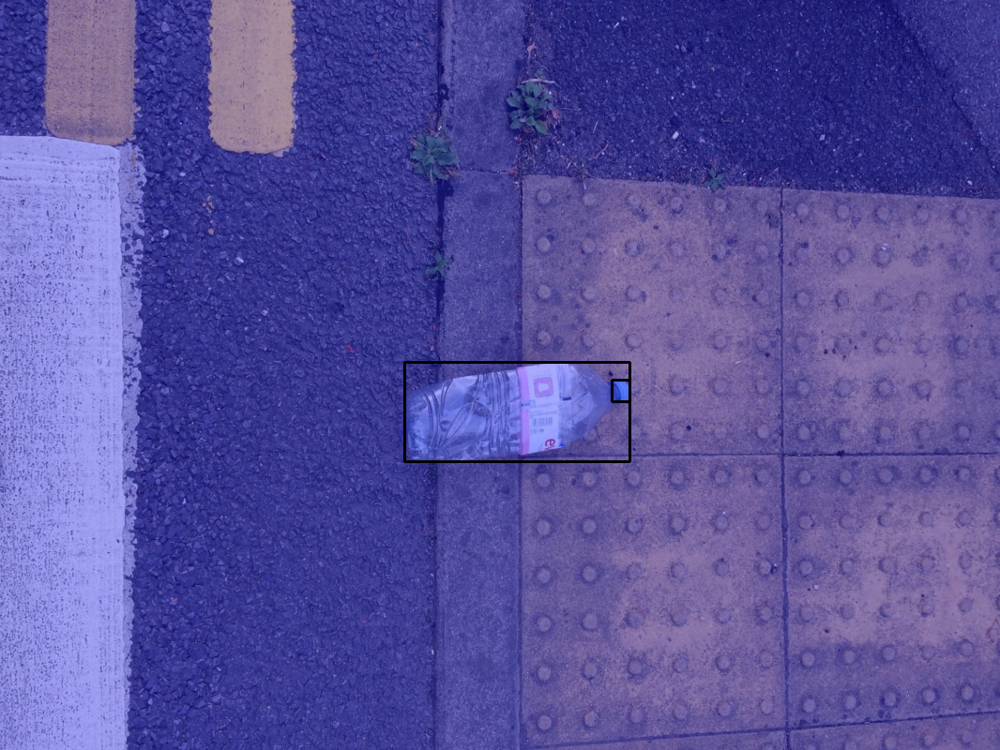

In [ ]:
Image.fromarray(image_with_bounding_boxes)

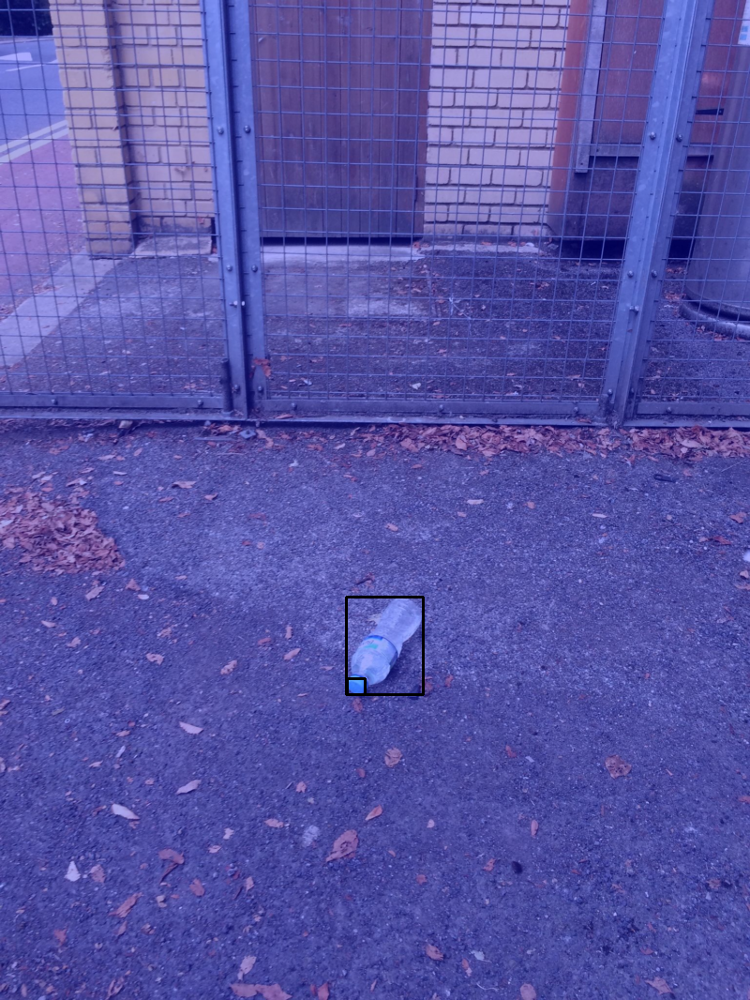

In [ ]:
Image.fromarray(image_with_bounding_boxes)

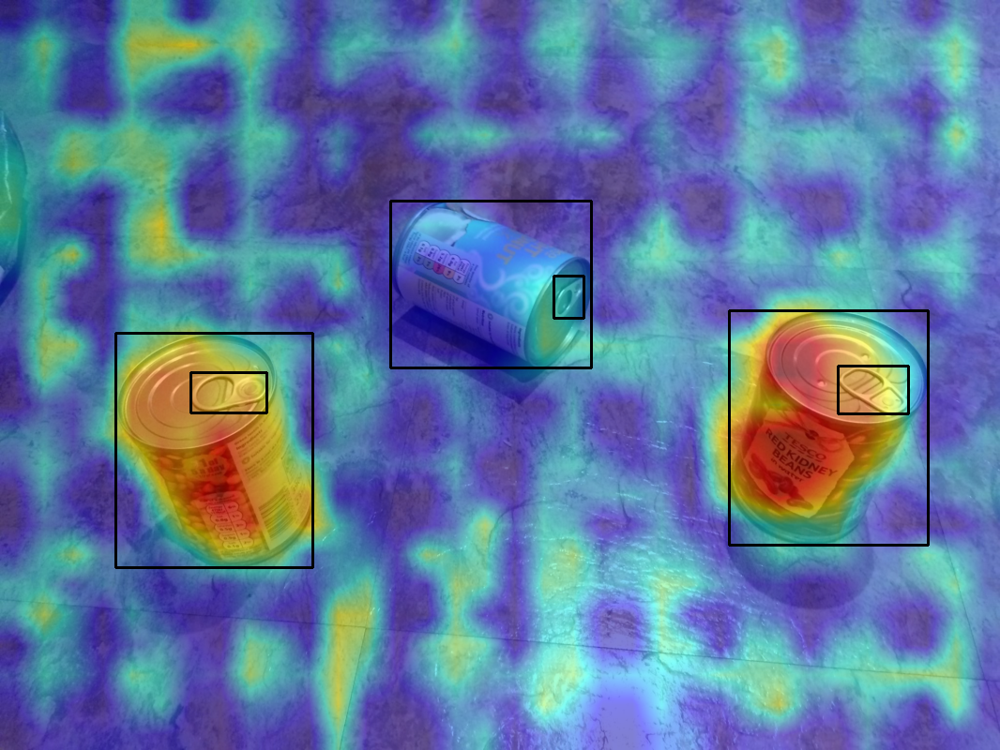

In [ ]:
Image.fromarray(image_with_bounding_boxes)

We encountered some problems with this CAM method, as often it didn't return any response at all. 

The only explanation we could give is linked to the complexity of the model, which would cause the gradient to vanish with some inputs.

When the GradCAM does return some saliency maps, they appear rather precise, but still present the typical artifacts provoked by the transformer backbone.
In fact, since the latter processes the image by breaking it down into regular patches, the CAM methods show some excited areas along the border of these pathces,
returning a grid-like artifact on the explaination  

## AblationCAM examples


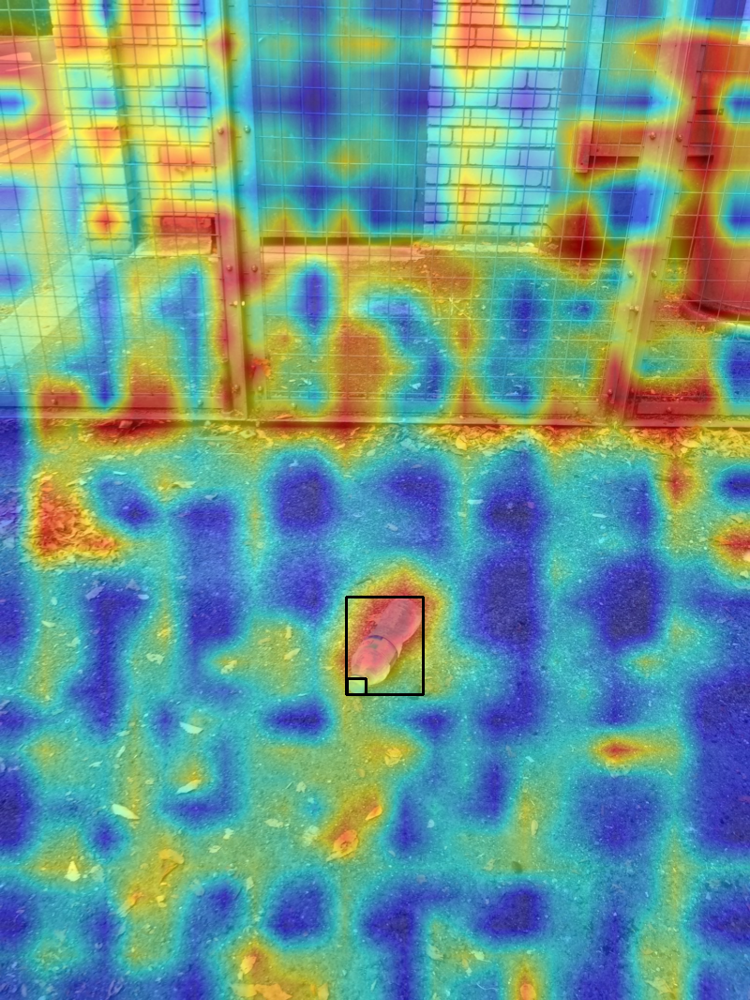

In [ ]:
Image.fromarray(image_with_bounding_boxes)

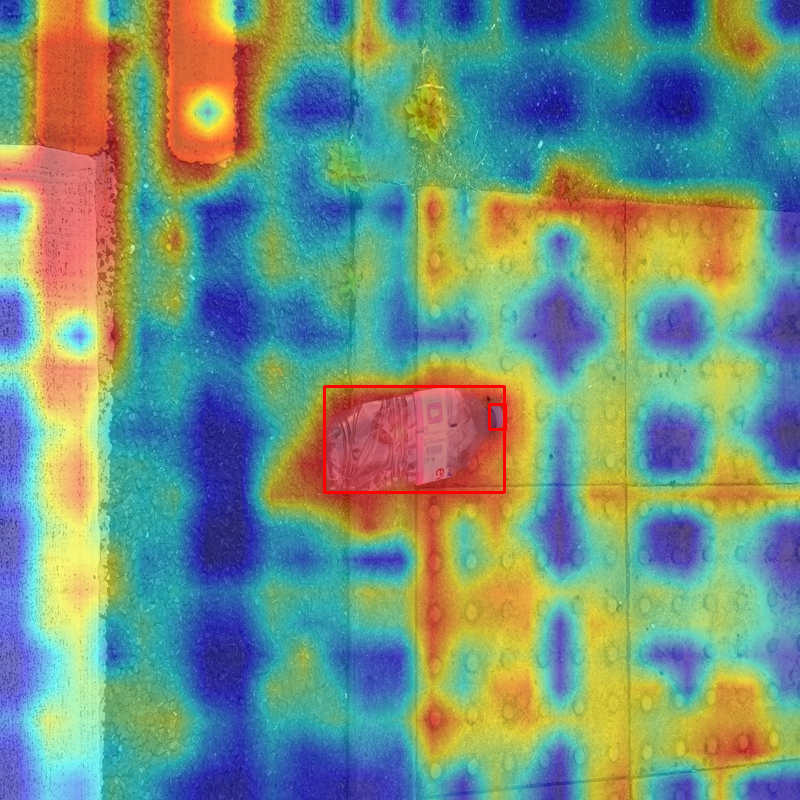

In [ ]:
Image.fromarray(image_with_bounding_boxes)

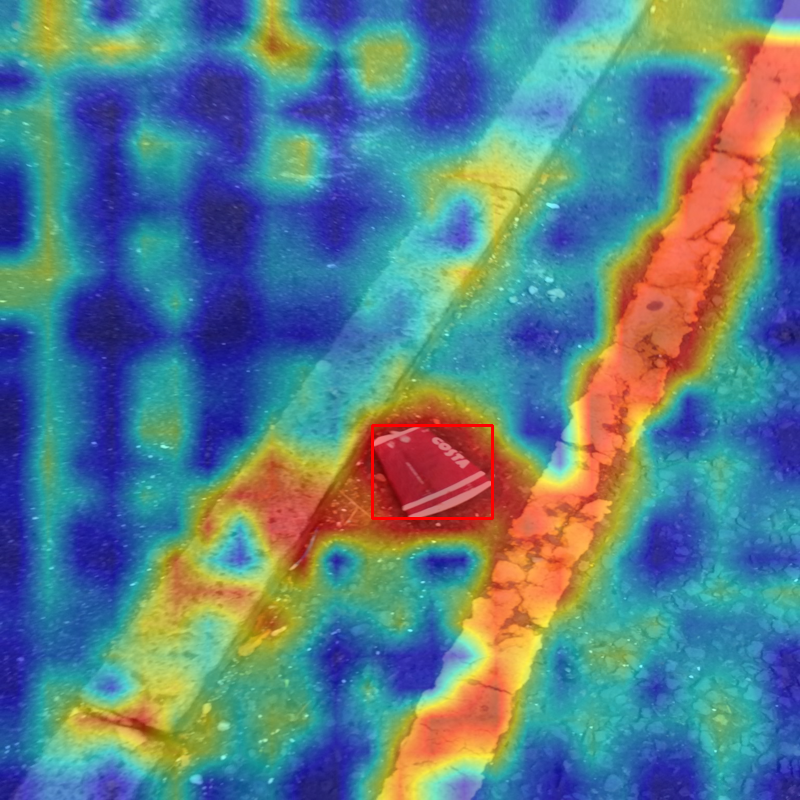

In [ ]:
Image.fromarray(image_with_bounding_boxes)

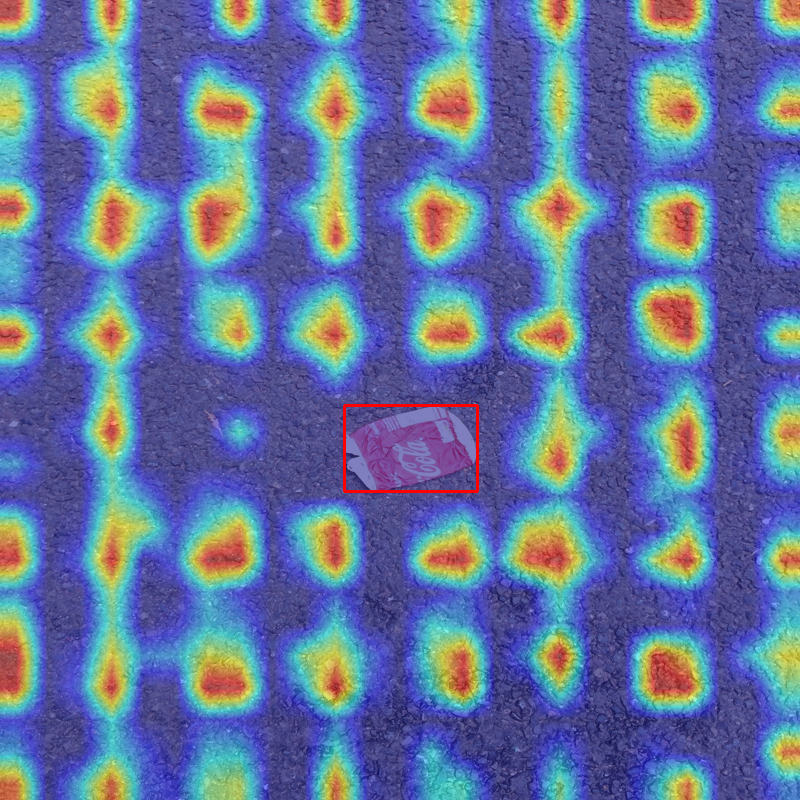

In [ ]:
Image.fromarray(image_with_bounding_boxes)

## EigenCAM examples

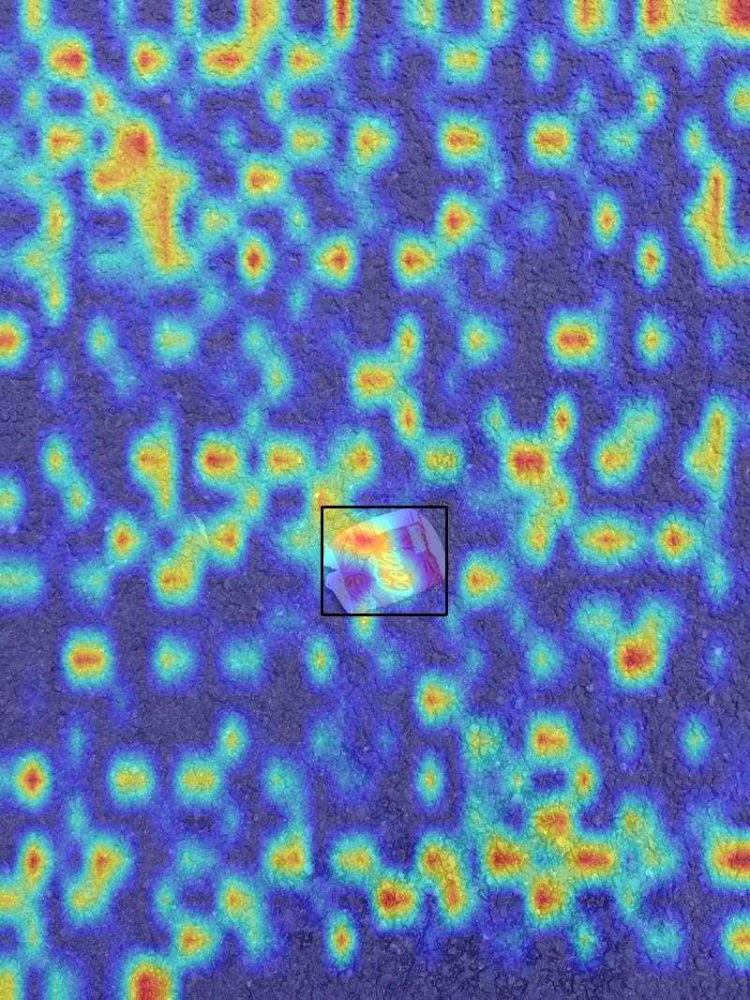

In [ ]:
Image.fromarray(image_with_bounding_boxes)

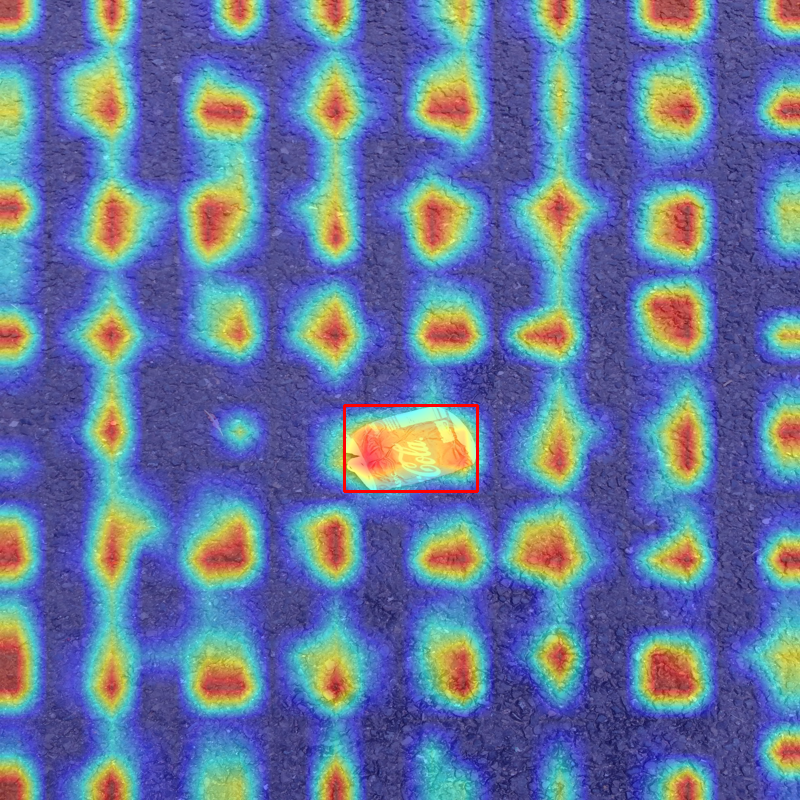

In [ ]:
Image.fromarray(image_with_bounding_boxes)

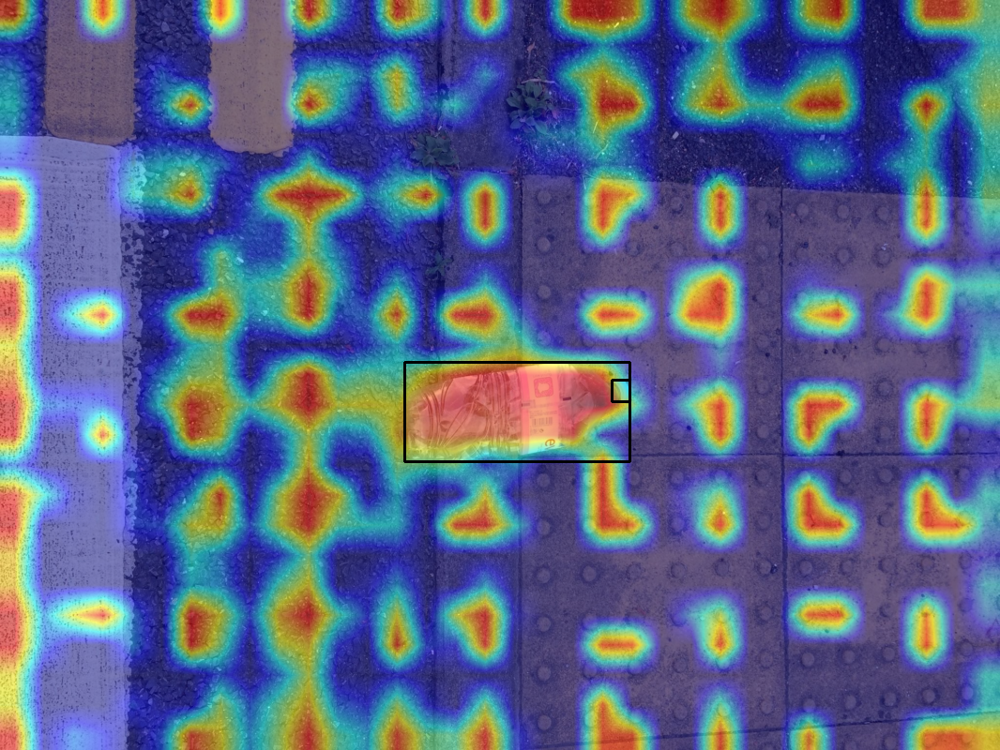

In [ ]:
Image.fromarray(image_with_bounding_boxes)

AblationCAM and EigenCAM also return similar maps, with strongly activated areas on the background and, mostly, on the detected object.

Both show the grid-like artifacts due to the transformer backbone, but the latter shows stronger activations at the corner of the patches, while the
former tends to highlight more uniformely blob-like objects.

## ScoreCAM examples

The ScoreCAM is the method that returned the most convincing explanations among the ones presented, so we focused on this method more.

A first peculiarity that we can notice is that if we feed a non-square image to the method, it may frequently return a hardly interpretable activation map. 
We also suppose this may be a consequence of how the transformer backbone deals with the feature extraction and the division of the image in regularly
shaped patches. The grid-shaped artifacts are also present, but they are less emphasized by the method.

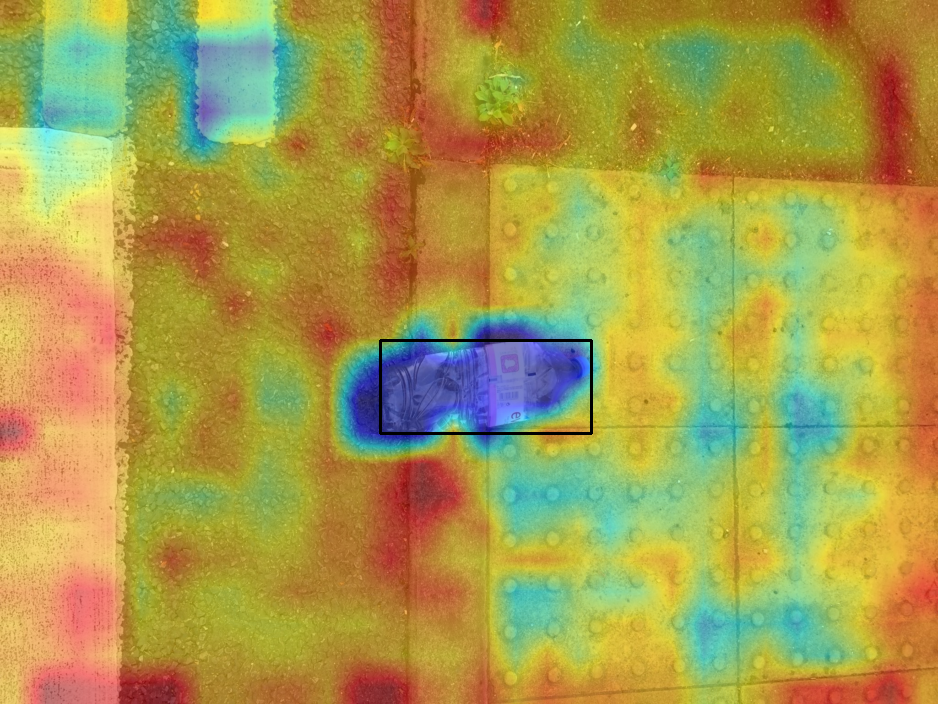

In [ ]:
Image.fromarray(image_with_bounding_boxes)

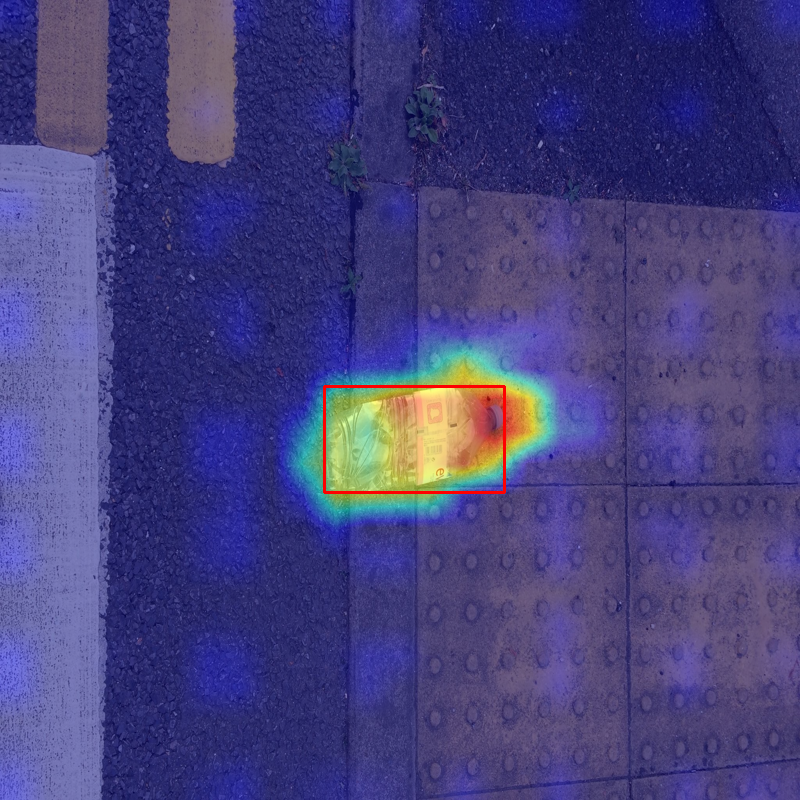

In [ ]:
Image.fromarray(image_with_bounding_boxes)

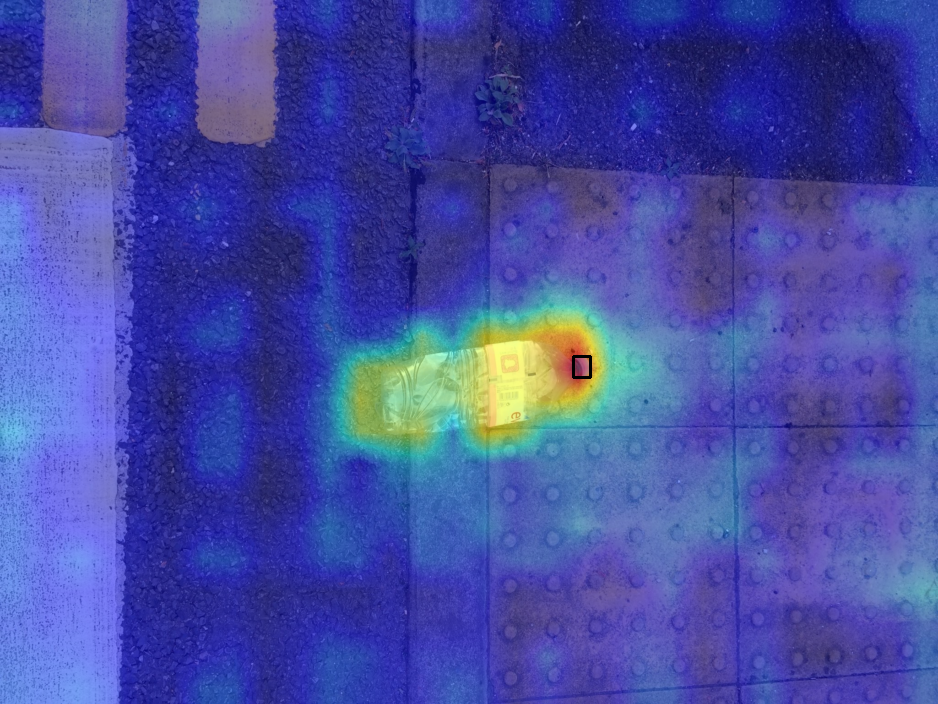

In [ ]:
Image.fromarray(image_with_bounding_boxes)

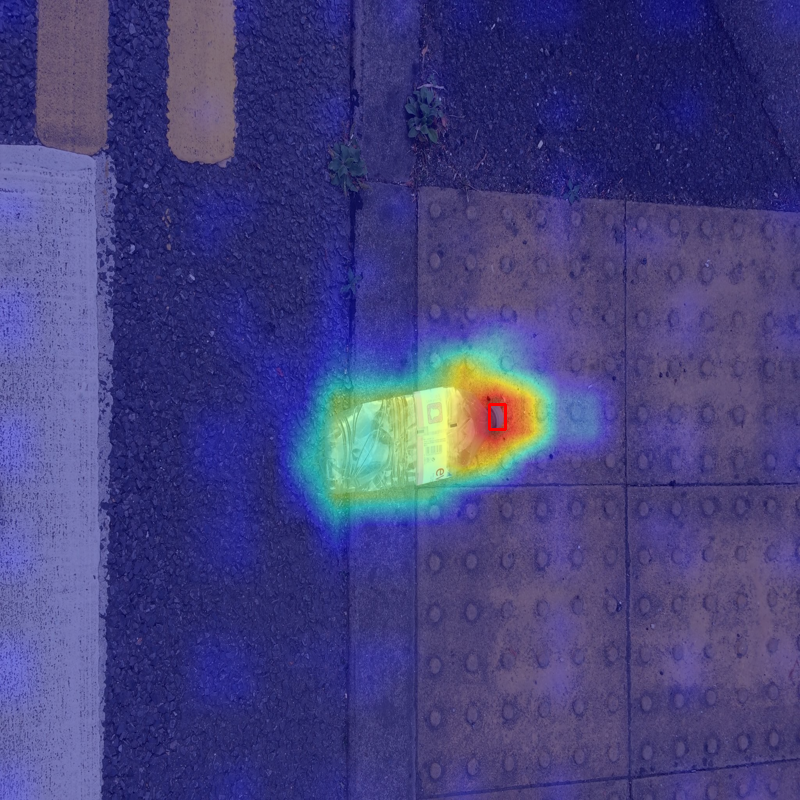

In [ ]:
Image.fromarray(image_with_bounding_boxes)

Among the interesting insights we can have on the model from this method is, as an example, the fact that if a bottle cap attached to a bottle is present in the image, also the bottle is highlighted as highly
contributing to the detection of the cap. 
We noticed that the model manages to detect bottle caps also when isolated from the bottle, so we should not interpret this information as possible overfitting, but as the model exploiting contextual information.

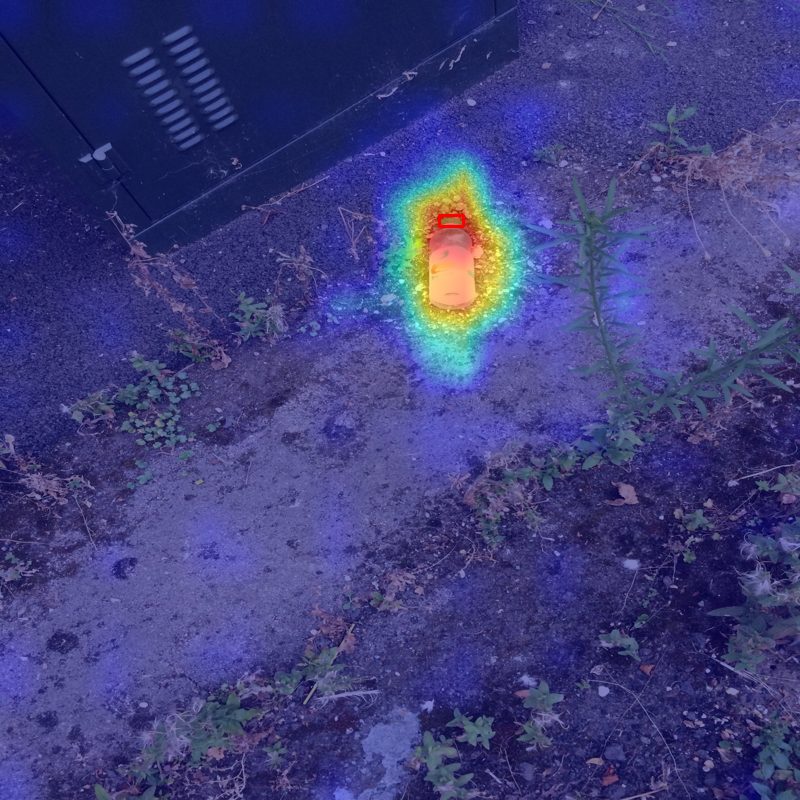

In [ ]:
Image.fromarray(image_with_bounding_boxes)

The following is also another interesting example showing the activation for three different objects belonging to three different classes.
Maybe the most notable particular is the fact that when the model focuses on the "Can" class, also the bottle is faintly highlighted suggesting
either strong co-occurrence of the classes in the training dataset or simply similarity given by the shape of the objects.

Differently, when focusing on the bottle, the can is not higlighted, but there is a strong activation in the point where the bottle cap should be, suggesting again that the model is trying to exploit contextual information.

- Highlighting "Plastic Bag & wrapper" class

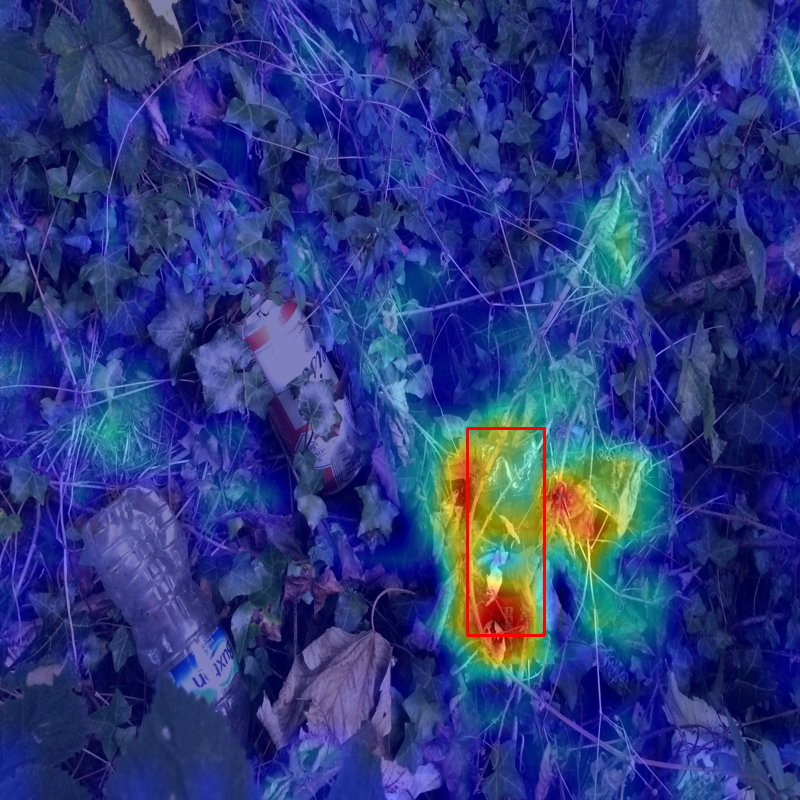

In [ ]:
#Higlighting class 
Image.fromarray(image_with_bounding_boxes)

- Highlighting "Can" class

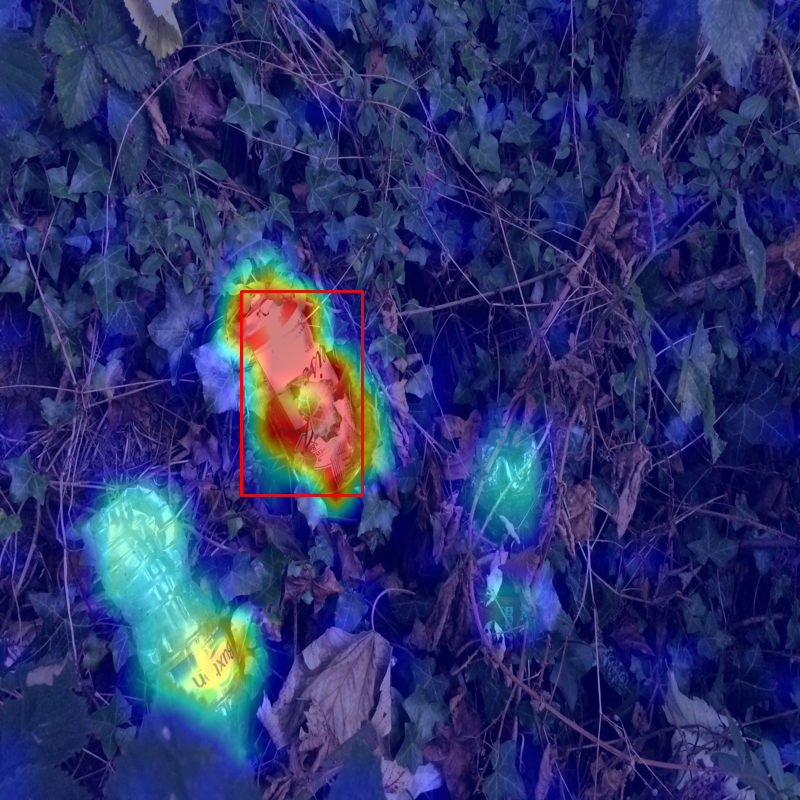

In [ ]:
Image.fromarray(image_with_bounding_boxes)

- Highlighting "Bottle" class

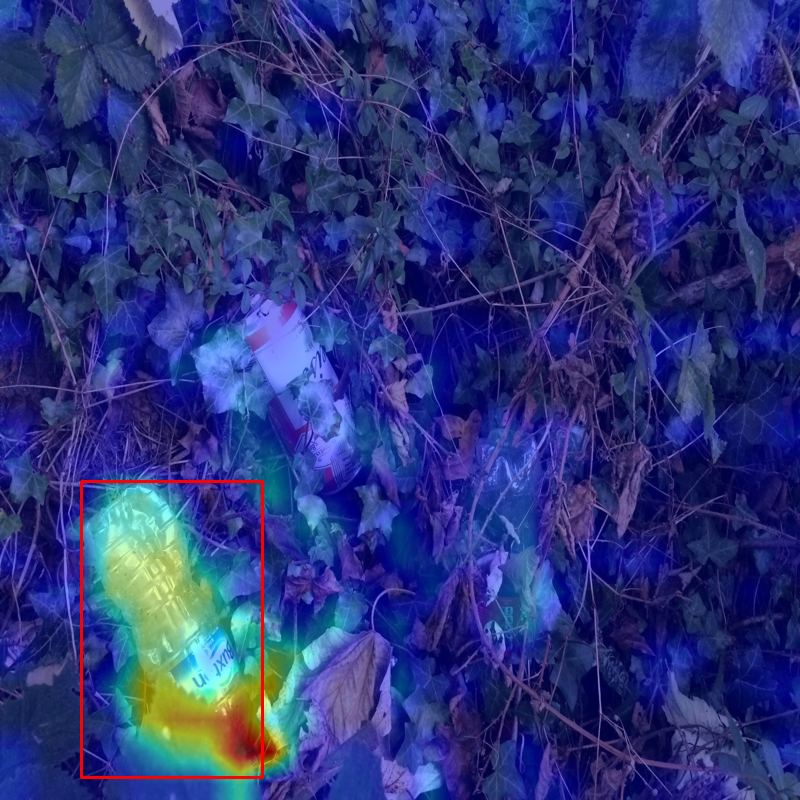

In [ ]:
Image.fromarray(image_with_bounding_boxes)

## ScoreCAM example Test Set

Finally we show a couple of examples extracted from the test set.

The first image shows three bath products in what seems to be a bathroom. 
We select some of the predicted bboxes and produce the ScoreCAM activations. 

Class "Bottle Cap" - All BBox

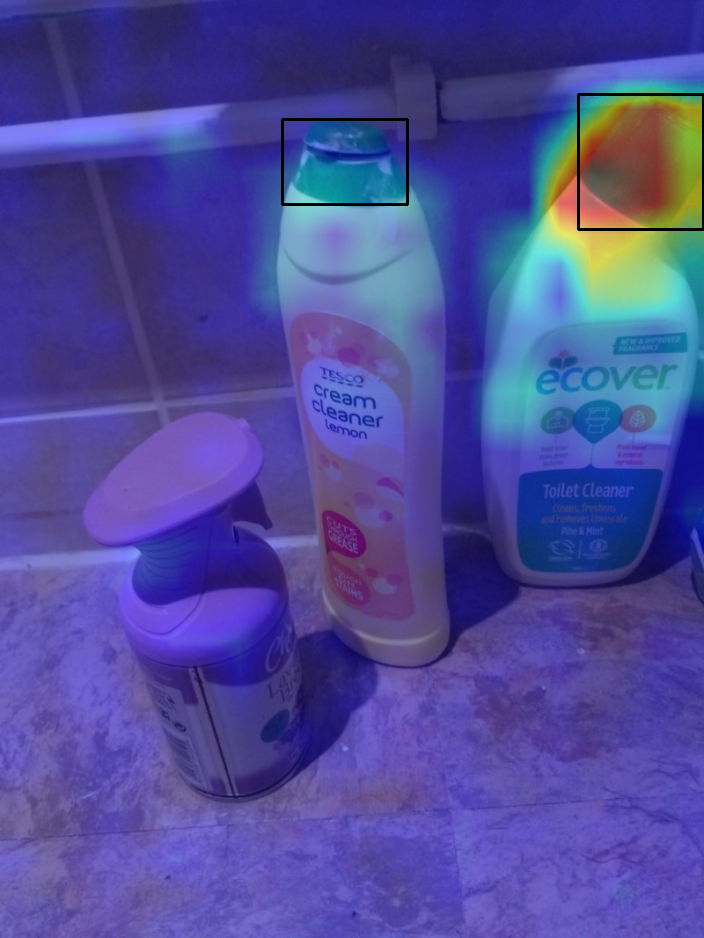

In [ ]:
Image.fromarray(image_with_bounding_boxes)

As we can notice, again, other than the bottle cap, also the high part of the bottle is highlighted, suggesting that the network is using contextual information.
These bottles are quite different from the common plastic ones that are present in the dataset, so maybe that's why not the whole bottle is highlighted

Class "Can" - All BBox

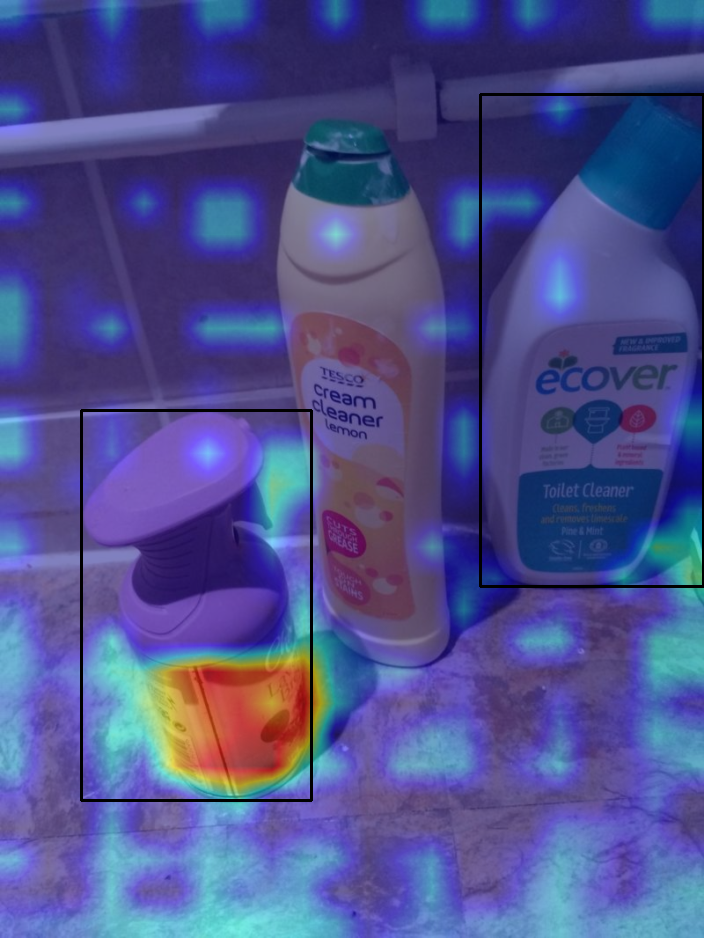

In [ ]:
Image.fromarray(image_with_bounding_boxes)

This activation is slightly noisy, but still focuses on the tin bottle on the left. The other bottle on the right is also detected, but
probably the score was lower than the box detecting it as bottle (N.B. the same box outputed by the DETR may be duplicated with different classes in the MFDETR output).

Class "Lid" - All BBox

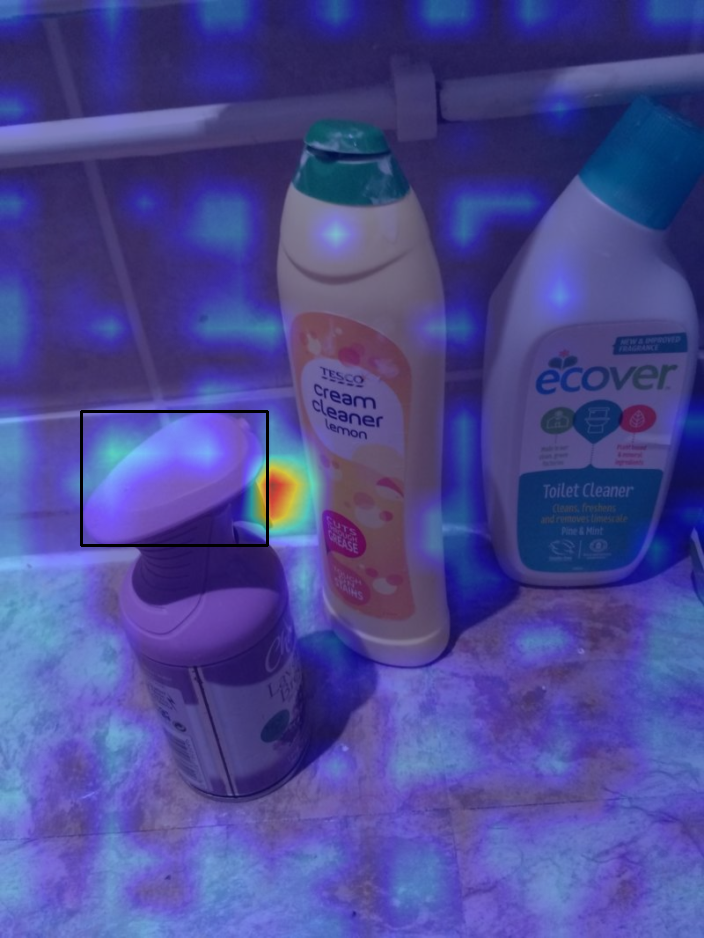

In [ ]:
Image.fromarray(image_with_bounding_boxes)

This map is also peculiar, as it focuses on the mouth of the sprinkler to detect the upper part of the can as lid.
It's objectively a strange activation, and if we want to force an explanation it may be that the model interprets that part as some element
of a lid (a "lock" piece, a pop tab...).

Class "Other" - All BBox

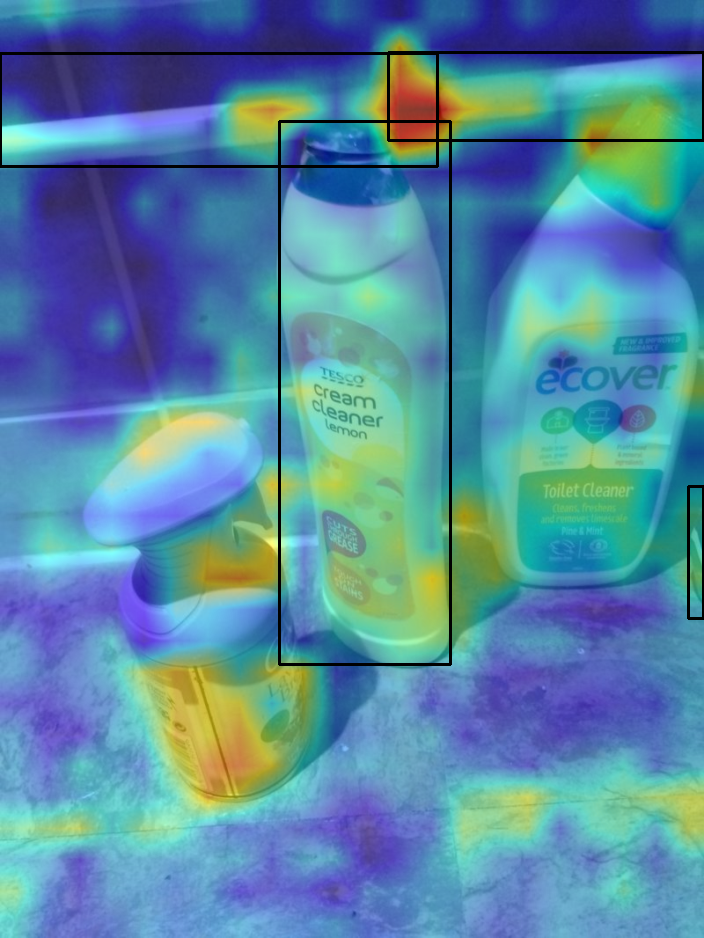

In [ ]:
Image.fromarray(image_with_bounding_boxes)

With class "other", which is an umbrella class for all the specific or unidentified litter, the map is mostly active everywhere and expecially on the 
white bar, which seems a bathroom furniture piece. It has sense that a seemingly plastic element with strange shape would be detected and segmented as "Other" litter. 

Finally, we present another image which stood out during the inspection of the outputs.

This image contains a single object, probably a blue cloth piece, labeled in the ground truth as "Other".
The model predicts it as "Cup", thus we want to explore why.

Top prediction - Class "Cup"

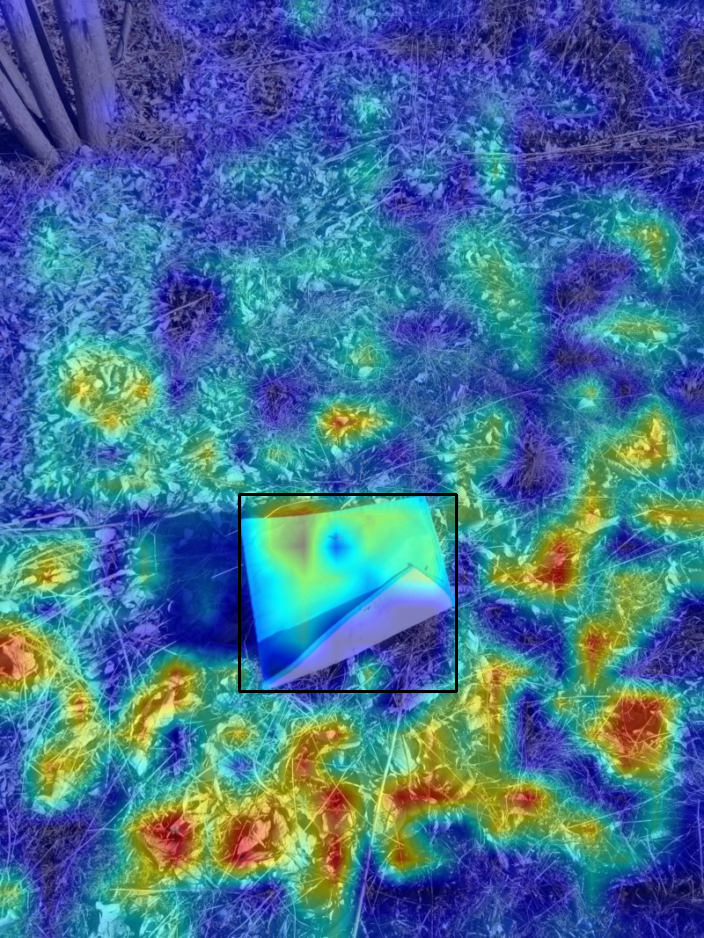

In [ ]:
Image.fromarray(image_with_bounding_boxes)

The activation is not particulary precise and focuses on the dead leaves and weed around the object. If we, however, focus within the bounding box, we can see that the higlighted part of the object is the bright blue section of the cloth, while the folded white part is somewhat ignored. 

A simple interpretation would suggest that the color and texture, plus the particular shape in which the cloth is folded, manages to fool the model which only looks at a blue-trapezioid (which could resamble a cup shape) and interprets the white part as an occlusion to the object not belonging to it (even if its segmentation section correctly segments the full object.)